<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"></ul></div>

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
from scipy.integrate import odeint
import numpy as np
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401 unused import
import plotly.graph_objects as go
import plotly.io as pio

In [12]:
def motion(t, val, sigma, rho, beta):
    """
    Questa funzione definisce gli incrementi secondo il formato utile a 'solve_ivp' di scykit_learn.
    """
    # Dentro a val metti solo gli Initial values
    x, y, z = val
    diff = [sigma * ( y - x ),
            rho * x - y - x * z,
            - beta * z + x * y 
           ]
    return diff


def scikit_ivp_solver(t, init, sigma, rho, beta, my_method):
    """
    Chiamo la funzione di IVP ed return degli array con soluzione
    """
    # Chiamata al Solver:
    sol = solve_ivp(motion,            # Funzione con gli incrementi definita sopra
                    [t[0], t[-1]],     # Span di integrazione (intervallo in cui vuoi integrare), ho messo l'intero t
                    init,              # Valori iniziali 
                    t_eval=t,          # Vettore con i tempi in cui vuoi valutare il problema
                    args=[sigma, rho, beta],# Argomenti richiesti dall'IVP 
                    method=my_method,  # Metodo di integrazione (tipo 'RK45', 'Radau',...)
                    max_step = 0.1)  
                                       # Per tutti i metodi visita --> 
    # --> https://docs.scipy.org/doc/scipy/reference/generated/scipy.integrate.solve_ivp.html#scipy.integrate.solve_ivp
    
    # I risultati stanno in sol.y
    x = sol.y[0,:]     # [0,:] indica che prendo tutti i punti in posizione 0
    y = sol.y[1,:]     # [1,:] indica che prendo tutti i punti in posizione 1
    z = sol.y[2,:]     # [2,:] indica che prendo tutti i punti in posizione 2
    return x, y, z

def main_1initial(my_method):
    """
    Main per integrare con il metodo my_method (da passare a solve_ivp).
    Restitiusce il plot (da gestire esternamente con plt.show(), ad esempio).
    """
    n = 2000000
    t = np.linspace(0, 200, n)
    
    # Parameters
    sigma = 10
    rho = 28
    beta = 8/3
    param = [sigma, rho, beta]
    
    # Inital Values
    x0 = 0.
    y0 = 1.
    z0 = 10.
    
    init = [x0, y0, z0]
    
    # Richiamo il "gestore di integrazione"
    x, y, z = scikit_ivp_solver(t, init, *param, my_method)
    
    marker_data = go.Scatter3d(
                    x=x[::10],
                    y=y[::10], 
                    z=z[::10], 
                    marker=go.scatter3d.Marker(size=1, color='blue'), 
                    opacity=0.6, 
                    mode='markers',)
    fig=go.Figure(data=marker_data)
    fig.show()
main_1initial('DOP853')

[-13.66666667 -13.66666667 -13.66666667 ... -13.66666666 -13.66666667
 -13.66666667]


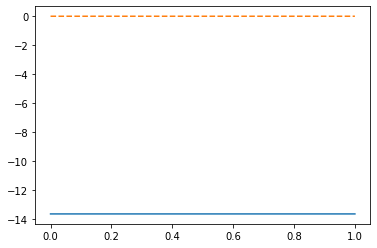

In [9]:
def Fx(x, y, sigma):
    return sigma * ( y - x )
    
def Fy(x, y, z, rho):
    return rho * x - y - x * z
    
def Fz(x, y, z, beta):
    return - beta * z + x * y 


def find_divergence(my_method):
    n = 1000000
    t = np.linspace(0, 1, n)
    
    # Parameters
    sigma = 10
    rho = 28
    beta = 8/3
    param = [sigma, rho, beta]
    
    # Inital Values
    x0 = 0.
    y0 = 1.
    z0 = 10.
    
    init = [x0, y0, z0]
    
    # Richiamo il "gestore di integrazione"
    sol = solve_ivp(motion,            # Funzione con gli incrementi definita sopra
                [t[0], t[-1]],     # Span di integrazione (intervallo in cui vuoi integrare), ho messo l'intero t
                init,              # Valori iniziali 
                t_eval=t,          # Vettore con i tempi in cui vuoi valutare il problema
                args=[sigma, rho, beta],# Argomenti richiesti dall'IVP 
                method=my_method,  # Metodo di integrazione (tipo 'RK45', 'Radau',...)
                max_step = 0.0001)  
    
    # I risultati stanno in sol.y
    x = sol.y[0,:]     # [0,:] indica che prendo tutti i punti in posizione 0
    y = sol.y[1,:]     # [1,:] indica che prendo tutti i punti in posizione 1
    z = sol.y[2,:]     # [2,:] indica che prendo tutti i punti in posizione 2
    
    aux = x[1:] - x[:-1]
    auy = y[1:] - y[:-1]
    auz = z[1:] - z[:-1]
    time = sol.t
    val = x, y, z
    
    dFx = Fx(x[1:], y[:-1], sigma) - Fx(x[:-1], y[:-1], sigma)
    dFy = Fy(x[:-1], y[1:], z[:-1], rho) - Fy(x[:-1], y[:-1], z[:-1], rho)
    dFz = Fz(x[:-1], y[:-1], z[1:], beta) - Fz(x[:-1], y[:-1], z[:-1], beta)

    
    #dFx = Fx[2:] - Fx[:-2]
    #dFy = Fy[2:] - Fy[:-2]
    #dFz = Fz[2:] - Fz[:-2]
    
    divF = dFx/aux + dFy/auy + dFz/auz
    print(divF)
    
    plt.plot(time[:-1], divF)
    plt.plot(time, np.zeros(len(time)), linestyle='--')
    plt.show()
    
find_divergence('Radau')